## Sim Demo

### Imports

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from env.imports import *

/ext3/miniconda3/lib/python3.11/site-packages/pandas/core/arrays/masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (
2025-07-27 15:32:03.520083: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-07-27 15:32:05.384402: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI AVX512_BF16 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2025-07-27 15:32:07.192521: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
  import numpy.matlib 

In [3]:
import importlib
import data

import models
import sim.sim
import sim.sim_utils
from sim.sim_utils import bytes2human, print_system_usage
from sim.sim import Simulation
from sim.sim_run import single_sim_run

importlib.reload(sim.sim)
importlib.reload(sim.sim_run) 

<module 'sim.sim_run' from '/scratch/asr655/neuroinformatics/GeneEx2Conn/sim/sim_run.py'>

#### Check job specs

In [4]:
print_system_usage()

total = psutil.disk_usage('/').total
print(bytes2human(total))

CPU Usage: 20.1%
RAM Usage: 5.9%
Available RAM: 1.4T
Total RAM: 1.5T
52.4G


In [5]:
print(os.environ.get("CUDA_VISIBLE_DEVICES"))

# Check available GPUs
print(f"Available GPUs: {torch.cuda.device_count()}")

for i in range(torch.cuda.device_count()):
    print(f"GPU {i}: {torch.cuda.get_device_name(i)} - Memory Allocated: {torch.cuda.memory_allocated(i)/1024**3:.2f} GB")


0
Available GPUs: 1
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.00 GB


In [6]:
print("XGBoost version:", xgboost.__version__)
print("cupy version:", cp.__version__)

GPUtil.getAvailable()

# if a number is seen a GPU is available
GPUtil.getGPUs()

DEVICE_ID_LIST = GPUtil.getFirstAvailable()
DEVICE_ID = DEVICE_ID_LIST[0] # grab first element from list
if DEVICE_ID != None: 
    print('GPU found', DEVICE_ID)
    use_gpu = True

    GPUtil.showUtilization()

XGBoost version: 2.0.3
cupy version: 13.1.0
GPU found 0
| ID | GPU | MEM |
------------------
|  0 |  0% |  0% |


In [7]:
torch.cuda.is_available()

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

## Simulation tests <a id="sims"></a>

### Model Parameter Counts

#### **Linear Models**
- **PCA Bilinear:** 730  _(27 PCs)_
- **PLS Bilinear:** 101  _(10 PLS components)_
- **Bilinear Low-rank:** 73,800  _(rank 10)_
- **PLS MLP:** 158,993  _(10 PLS components, including PLS projection matrices)_
- **PCA MLP:** 47,873  _(27 PCs, 2-layer)_

---

#### **MLP and SMT Models**

#### 2-Layer Models
- **MLP:** 3,812,609
- **SMT:** 1,399,947
- **MLP w/ CLS:** 3,814,145
- **SMT w/ CLS:** 1,405,579

#### 3-Layer Models
- **MLP:** 7,723,777
- **SMT:** 2,162,315
- **MLP w/ CLS:** 7,726,849
- **SMT w/ CLS:** 2,173,067

---

### Coord MLP Parameter Counts
- **[32]:** 321
- **[64, 32]:** 2,753
- **[128, 64]:** 9,601
- **[256, 128]:** 35,685
- **[512, 256, 128]:** 169,729


Number of regions per lobe:
Frontal: 132
Parietal: 121
Temporal: 95
Occipital: 52
Subcortex: 46
Cerebellum: 10


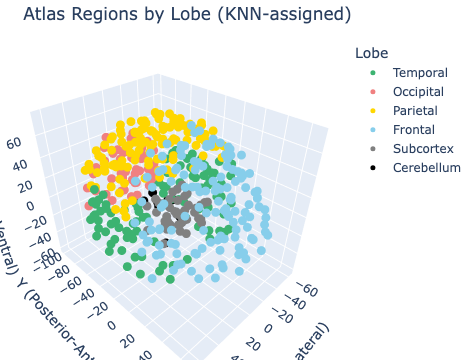

In [8]:
import pandas as pd
import plotly.express as px

# Load updated atlas
df = pd.read_csv("./data/UKBB/atlas-4S456Parcels_dseg_reformatted.csv")

# Fallback hover name if 'parcel_name' is missing
hover_col = "parcel_name" if "parcel_name" in df.columns else "label"
df["hover_label"] = df[hover_col]

# Set unknown lobes to "Unknown"
df["Lobe"] = df["lobe"].fillna("Unknown")

# Count number of regions per lobe
lobe_counts = df["Lobe"].value_counts()
print("\nNumber of regions per lobe:")
for lobe, count in lobe_counts.items():
    print(f"{lobe}: {count}")

# Plot
fig = px.scatter_3d(
    df,
    x="mni_x", y="mni_y", z="mni_z",
    color="Lobe",
    hover_name="hover_label",
    opacity=1,
    color_discrete_map={
        "Frontal": "skyblue",
        "Temporal": "mediumseagreen",
        "Parietal": "gold",
        "Occipital": "lightcoral",
        "Subcortex": "gray",
        "Cerebellum": "black"
    }
)

fig.update_traces(marker=dict(size=5))
fig.update_layout(
    title="Atlas Regions by Lobe (KNN-assigned)",
    scene=dict(
        xaxis_title="X (Lateral)",
        yaxis_title="Y (Posterior-Anterior)",
        zaxis_title="Z (Dorsal-Ventral)"
    ),
    margin=dict(l=0, r=0, b=0, t=40)
)

fig.show()

In [10]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='UKBB',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='lobe',
              random_seed=42,
              search_method=('wandb', 'mse', 4),
              track_wandb=True,
              skip_cv=True,
              model_type='shared_transformer',
              use_gpu=True, 
              null_model='none',
              use_folds=[5, 4, 3, 2, 1, 0]
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
Lobe coverage: 100.0% of regions
Lobe sizes: {'Temporal': 95, 'Occipital': 52, 'Parietal': 121, 'Frontal': 132, 'Subcortex': 46, 'Cerebellum': 9}
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: ozljv30r
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/ozljv30r
Initialized sweep with ID: ozljv30r


  warnings.warn(

  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



Testing network: Temporal
Occipital
Parietal
Frontal
Subcortex
Cerebellum
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 60, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [512, 256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 1024, 'aug_prob': 0.4, 'epochs': 100, 'num_workers': 2, 'prefetch_factor': 4}
Number of learnable parameters in SMT model: 2162315


  from IPython.core.display import HTML, display  # type: ignore



Using 2 workers and 4 prefetch factor
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.07 GB
Best val loss so far at epoch 1: 0.0407
Best val loss so far at epoch 2: 0.0369
Best val loss so far at epoch 3: 0.0355
Epoch 5/100, Train Loss: 0.0654, Val Loss: 0.0357, Time: 9.16s
Best val loss so far at epoch 6: 0.0318
Best val loss so far at epoch 7: 0.0315
Best val loss so far at epoch 8: 0.0305
Best val loss so far at epoch 10: 0.0274
Epoch 10/100, Train Loss: 0.0457, Val Loss: 0.0274, Time: 8.43s
Best val loss so far at epoch 15: 0.0272
Epoch 15/100, Train Loss: 0.0410, Val Loss: 0.0272, Time: 9.45s
Best val loss so far at epoch 17: 0.0267
Epoch 20/100, Train Loss: 0.0359, Val Loss: 0.0271, Time: 8.71s
Best val loss so far at epoch 23: 0.0257
Epoch 25/100, Train Loss: 0.0326, Val Loss: 0.0280, Time: 9.07s
Epoch 30/100, Train Loss: 0.0311, Val Loss: 0.0260, Time: 8.73s
Best val loss so far at epoch 31: 0.0241


KeyboardInterrupt: 

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
Lobe coverage: 100.0% of regions
Lobe sizes: {'Temporal': 95, 'Occipital': 52, 'Parietal': 121, 'Frontal': 132, 'Subcortex': 46, 'Cerebellum': 9}
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


  return LooseVersion(v) >= LooseVersion(check)

ERROR: Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Using wandb-core as the SDK backend. Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: asratzan (alexander-ratzan-new-york-university). Use `wandb login --relogin` to force relogin
wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: hd73s3ak
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/hd73s3ak
Initialized sweep with ID: hd73s3ak
Testing network: Temporal
Occipital
Parietal
Frontal
Subcortex
Cerebellum
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 20, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [512, 256, 128], 'cls_init': 'spatial_learned', 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 0.0001, 'weight_decay': 0.0001, 'batch_size': 1024, 'aug_prob': 0.4, 'epochs': 100, 'num_workers': 2, 'prefetch_factor': 4}


  warnings.warn(



Number of learnable parameters in SMT w/ CLS model: 4686987


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



  from IPython.core.display import display



  from IPython.core.display import HTML, display  # type: ignore



Using 2 workers and 4 prefetch factor
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.02 GB
Best val loss so far at epoch 1: 0.0421
Best val loss so far at epoch 2: 0.0390
Best val loss so far at epoch 3: 0.0326
Epoch 5/100, Train Loss: 0.0608, Val Loss: 0.0363, Time: 12.52s
Epoch 10/100, Train Loss: 0.0467, Val Loss: 0.0400, Time: 16.16s
Epoch 15/100, Train Loss: 0.0331, Val Loss: 0.0332, Time: 14.84s
Epoch 20/100, Train Loss: 0.0246, Val Loss: 0.0349, Time: 12.84s

LR REDUCED: 0.000100 → 0.000030 at Val Loss: 0.036595
Epoch 25/100, Train Loss: 0.0233, Val Loss: 0.0368, Time: 13.11s
Epoch 30/100, Train Loss: 0.0240, Val Loss: 0.0386, Time: 13.89s
Epoch 35/100, Train Loss: 0.0211, Val Loss: 0.0369, Time: 13.51s
Epoch 40/100, Train Loss: 0.0209, Val Loss: 0.0363, Time: 13.15s
Epoch 45/100, Train Loss: 0.0200, Val Loss: 0.0346, Time: 12.85s

LR REDUCED: 0.000030 → 0.000009 at Val Loss: 0.033768

Early stopping triggered at epoch 48. Restoring best model with Val Los

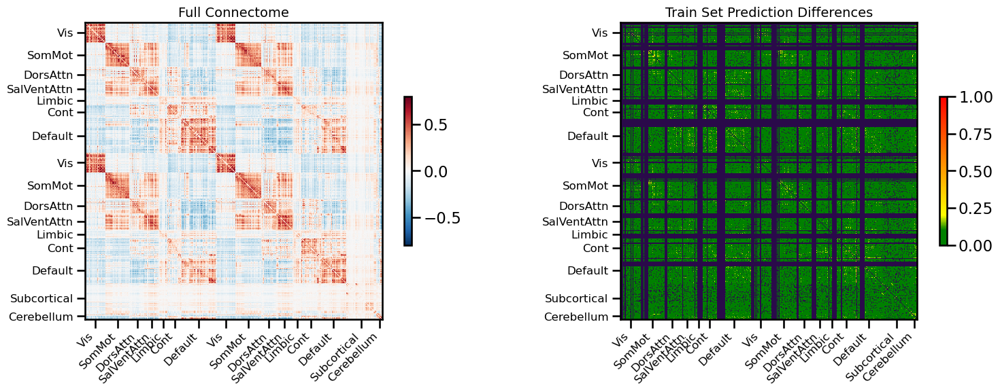

<Figure size 640x480 with 0 Axes>

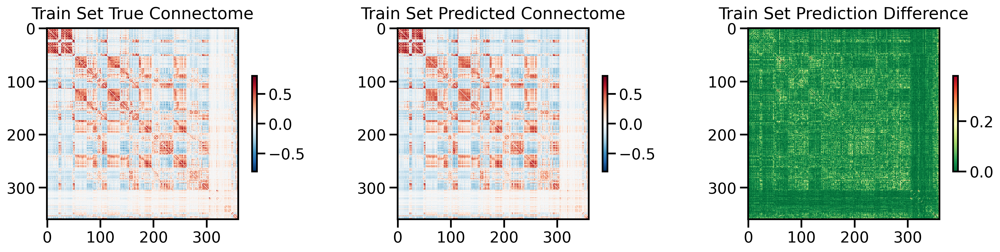

<Figure size 640x480 with 0 Axes>

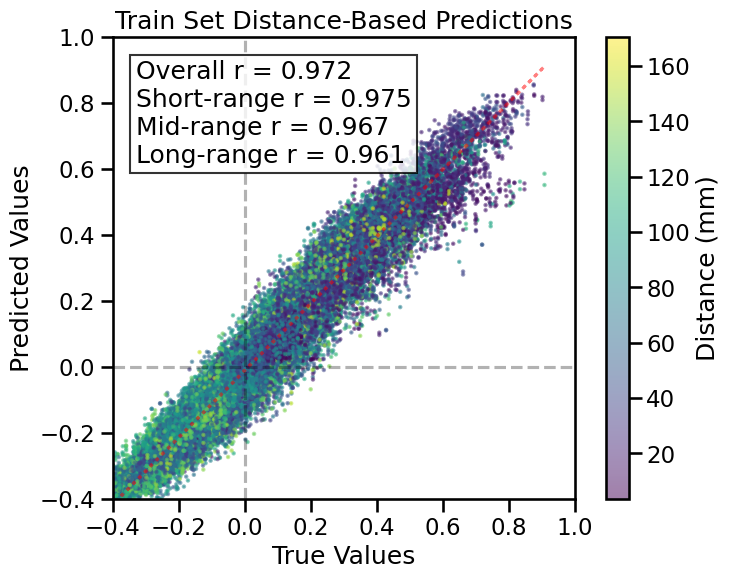

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 95 regions, 8930 connections


<Figure size 640x480 with 0 Axes>

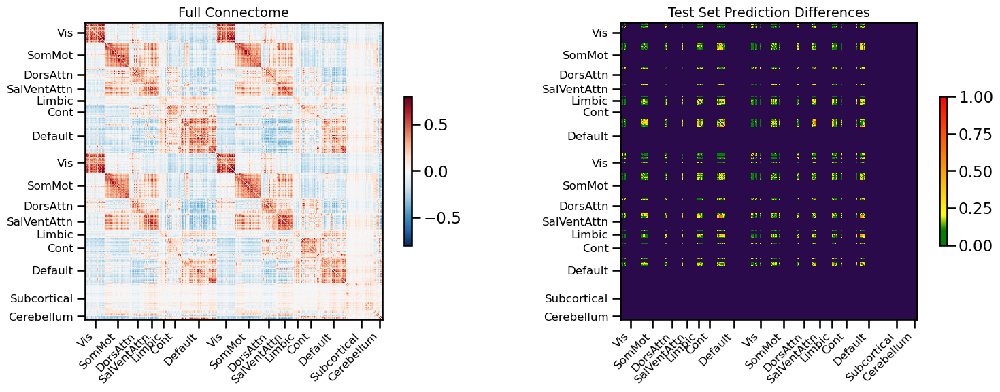

<Figure size 640x480 with 0 Axes>

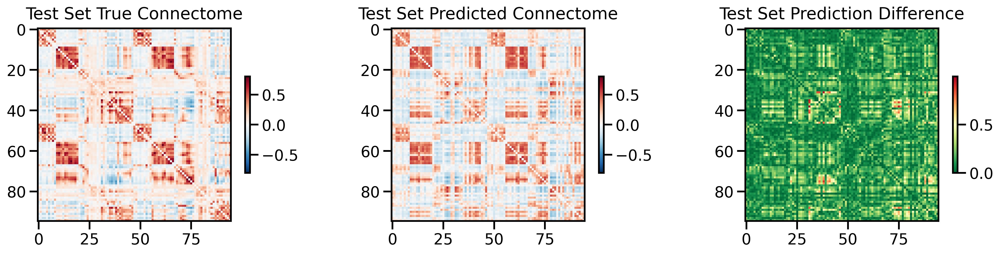

<Figure size 640x480 with 0 Axes>

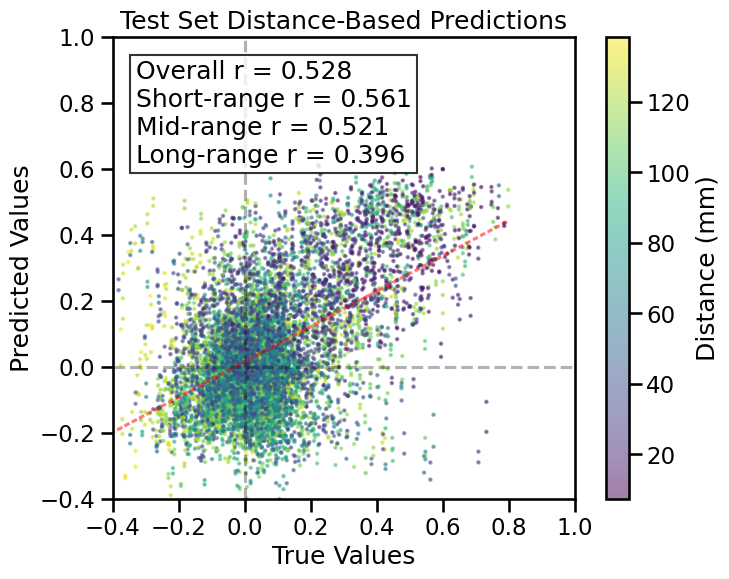

TRAIN METRICS
GLOBAL: mse=0.002248, mae=0.035051, r2=0.9374, pearson_r=0.9723, spearman_r=0.9668, geodesic_distance=15.3961
DISTANCE-BASED: short=0.9748, mid=0.9673, long=0.9615
HEMISPHERIC: left=0.9704, right=0.9750, inter=0.9722
CONNECTION STRENGTH: neg=0.5824, weak=0.9520, pos=0.8087
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9742    0.9743
  Default       0.9784    0.9751
  SalVentAttn    0.9712    0.9749
  Limbic        0.9812    0.9719
  DorsAttn      0.9709    0.9761
  SomMot        0.9763    0.9772
  Vis           0.9879    0.9799
  Subcortical    0.9702    0.9730
  Cerebellum    0.9495    0.9718

TEST METRICS
GLOBAL: mse=0.034266, mae=0.138541, r2=0.0351, pearson_r=0.5284, spearman_r=0.4216, geodesic_distance=9.4186
DISTANCE-BASED: short=0.5608, mid=0.5212, long=0.3964
HEMISPHERIC: left=0.5383, right=0.5189, inter=0.5199
CONNECTION STRENGTH: weak=0.2856, pos=0.3089
NETWORK CORRELATIONS:
  NETWORK      INTRA      INT

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▆▁▂▄██▆▆▆▂▂▁▂▃▂▃▄▄▅▄▄▅▅▄▄▅▄▄▄▄▃▂▄▃▃▃▂▂▃
train_mse_loss,█▅▄▄▃▃▂▂▂▂▂▂▂▂▂▂▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.03505
train_mse_loss,0.01414


Final evaluation metrics logged successfully.


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: p7jp0jok
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/p7jp0jok
Initialized sweep with ID: p7jp0jok


  warnings.warn(

  self.comm = Comm(**args)



Testing network: Occipital
Temporal
Parietal
Frontal
Subcortex
Cerebellum
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 20, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [512, 256, 128], 'cls_init': 'spatial_learned', 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 0.0001, 'weight_decay': 0.0001, 'batch_size': 1024, 'aug_prob': 0.4, 'epochs': 100, 'num_workers': 2, 'prefetch_factor': 4}
Number of learnable parameters in SMT w/ CLS model: 4686987


  from IPython.core.display import HTML, display  # type: ignore



Using 2 workers and 4 prefetch factor
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.15 GB
Best val loss so far at epoch 1: 0.1511
Best val loss so far at epoch 2: 0.1182
Best val loss so far at epoch 3: 0.1031
Epoch 5/100, Train Loss: 0.0610, Val Loss: 0.1226, Time: 17.14s
Epoch 10/100, Train Loss: 0.0397, Val Loss: 0.1088, Time: 17.55s
Best val loss so far at epoch 15: 0.0844
Epoch 15/100, Train Loss: 0.0324, Val Loss: 0.0844, Time: 17.10s
Best val loss so far at epoch 17: 0.0783
Best val loss so far at epoch 18: 0.0665
Best val loss so far at epoch 20: 0.0660
Epoch 20/100, Train Loss: 0.0202, Val Loss: 0.0660, Time: 15.46s
Best val loss so far at epoch 21: 0.0598
Best val loss so far at epoch 24: 0.0589
Best val loss so far at epoch 25: 0.0545
Epoch 25/100, Train Loss: 0.0227, Val Loss: 0.0545, Time: 15.73s
Best val loss so far at epoch 26: 0.0516
Best val loss so far at epoch 28: 0.0436
Best val loss so far at epoch 29: 0.0431
Epoch 30/100, Train Loss: 0.0205

<Figure size 640x480 with 0 Axes>

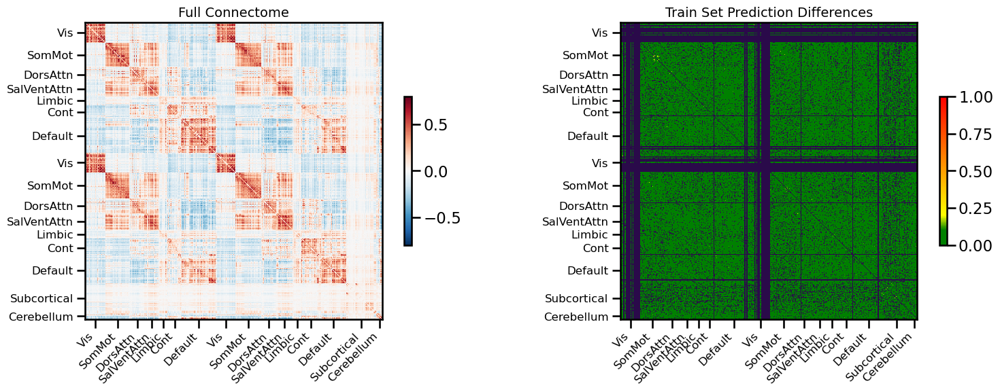

<Figure size 640x480 with 0 Axes>

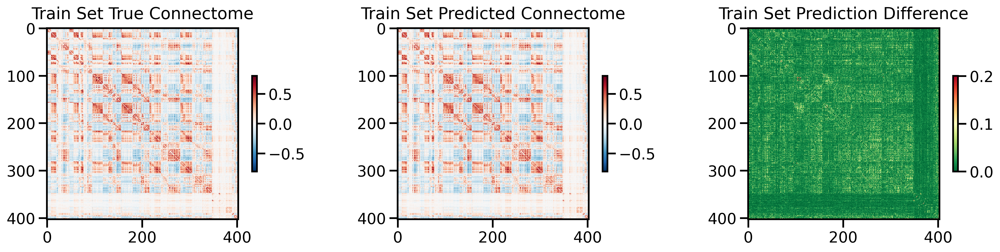

<Figure size 640x480 with 0 Axes>

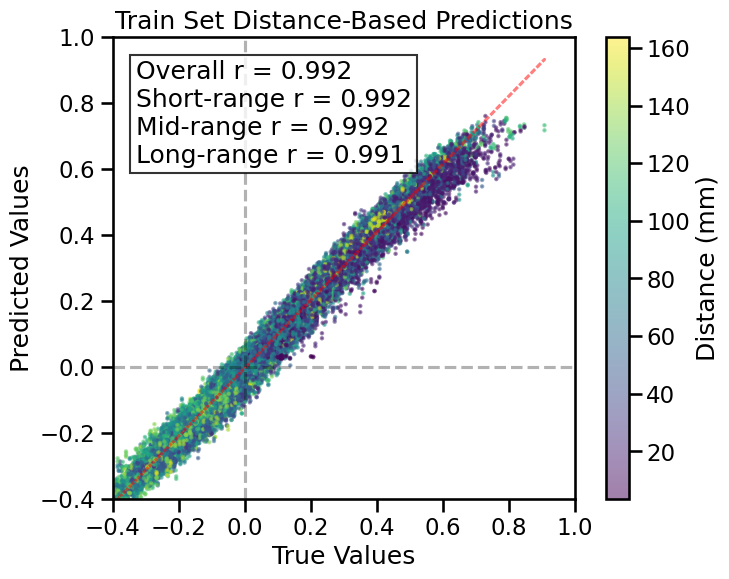

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 52 regions, 2652 connections


<Figure size 640x480 with 0 Axes>

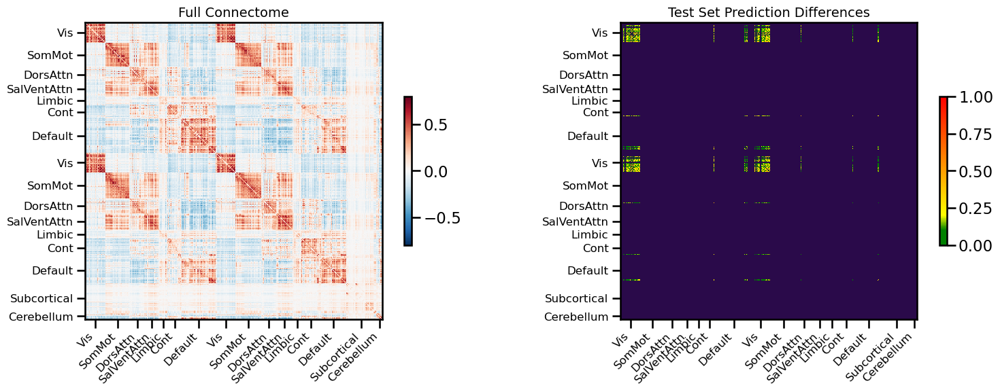

<Figure size 640x480 with 0 Axes>

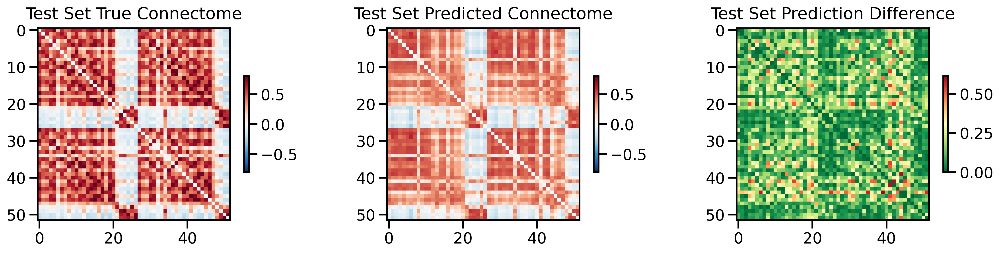

<Figure size 640x480 with 0 Axes>

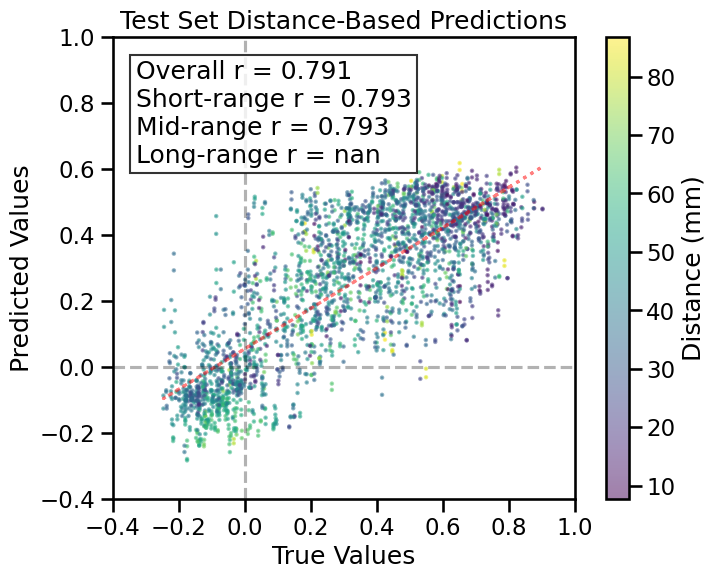

TRAIN METRICS
GLOBAL: mse=0.000610, mae=0.018463, r2=0.9813, pearson_r=0.9918, spearman_r=0.9890, geodesic_distance=14.0885
DISTANCE-BASED: short=0.9918, mid=0.9915, long=0.9910
HEMISPHERIC: left=0.9915, right=0.9923, inter=0.9916
CONNECTION STRENGTH: neg=0.8117, weak=0.9860, pos=0.9371
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9934    0.9924
  Default       0.9932    0.9921
  SalVentAttn    0.9925    0.9923
  Limbic        0.9956    0.9944
  DorsAttn      0.9889    0.9908
  SomMot        0.9887    0.9909
  Vis           0.9836    0.9820
  Subcortical    0.9947    0.9921
  Cerebellum    0.9076    0.9923

TEST METRICS
GLOBAL: mse=0.036884, mae=0.149934, r2=0.5771, pearson_r=0.7913, spearman_r=0.7542, geodesic_distance=4.9575
DISTANCE-BASED: short=0.7928, mid=0.7930
HEMISPHERIC: left=0.8209, right=0.7557, inter=0.7955
CONNECTION STRENGTH: weak=0.7017, pos=0.2625
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  --------

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,▇▆▆██▆▅▄▃▃▂▂▂▁▁▂▃▃▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_mse_loss,█▆▅▄▄▃▃▃▂▂▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.03733
train_mse_loss,0.0017


Final evaluation metrics logged successfully.


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: t70i6z76
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/t70i6z76
Initialized sweep with ID: t70i6z76


  warnings.warn(

  self.comm = Comm(**args)



Testing network: Parietal
Temporal
Occipital
Frontal
Subcortex
Cerebellum
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 20, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [512, 256, 128], 'cls_init': 'spatial_learned', 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 0.0001, 'weight_decay': 0.0001, 'batch_size': 1024, 'aug_prob': 0.4, 'epochs': 100, 'num_workers': 2, 'prefetch_factor': 4}
Number of learnable parameters in SMT w/ CLS model: 4686987


  from IPython.core.display import HTML, display  # type: ignore



Using 2 workers and 4 prefetch factor
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.15 GB
Best val loss so far at epoch 1: 0.0767
Best val loss so far at epoch 2: 0.0647
Best val loss so far at epoch 3: 0.0638
Epoch 5/100, Train Loss: 0.0647, Val Loss: 0.0734, Time: 11.52s
Best val loss so far at epoch 9: 0.0637
Best val loss so far at epoch 10: 0.0615
Epoch 10/100, Train Loss: 0.0443, Val Loss: 0.0615, Time: 13.85s
Best val loss so far at epoch 11: 0.0598
Best val loss so far at epoch 12: 0.0584
Best val loss so far at epoch 13: 0.0577
Best val loss so far at epoch 14: 0.0543
Best val loss so far at epoch 15: 0.0534
Epoch 15/100, Train Loss: 0.0309, Val Loss: 0.0534, Time: 11.03s
Best val loss so far at epoch 16: 0.0506
Best val loss so far at epoch 17: 0.0458
Epoch 20/100, Train Loss: 0.0228, Val Loss: 0.0467, Time: 10.23s
Best val loss so far at epoch 21: 0.0446
Best val loss so far at epoch 25: 0.0433
Epoch 25/100, Train Loss: 0.0250, Val Loss: 0.0433, Time:

<Figure size 640x480 with 0 Axes>

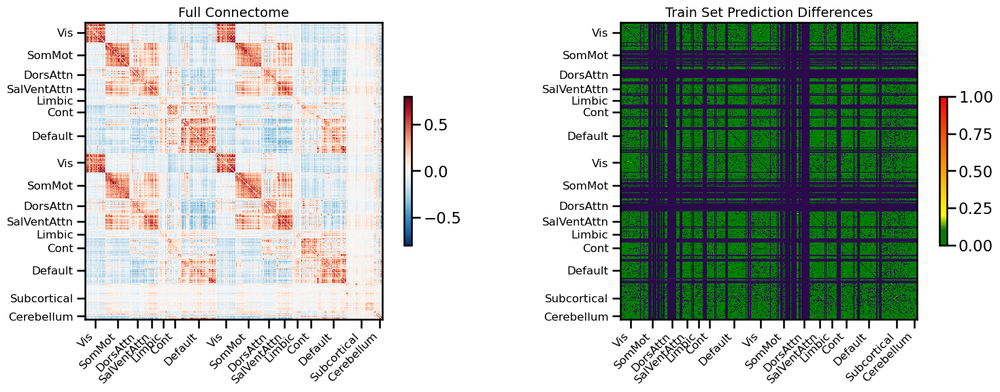

<Figure size 640x480 with 0 Axes>

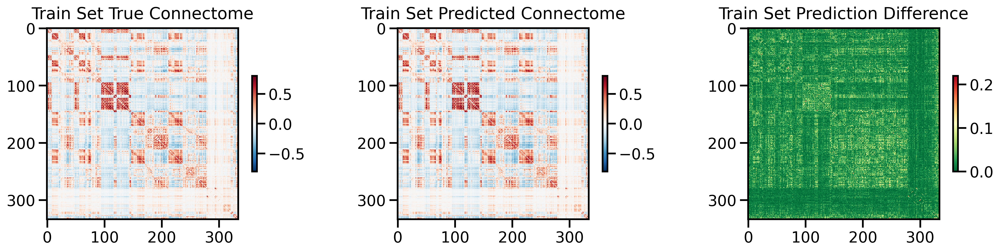

<Figure size 640x480 with 0 Axes>

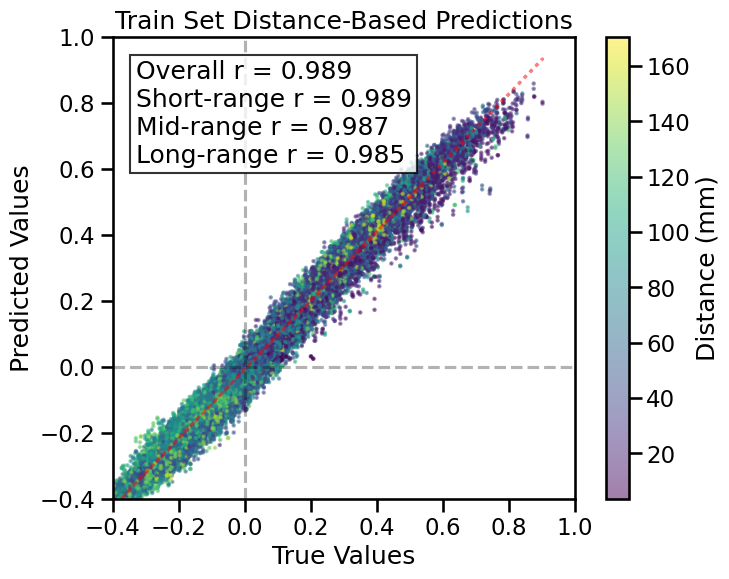

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 121 regions, 14520 connections


<Figure size 640x480 with 0 Axes>

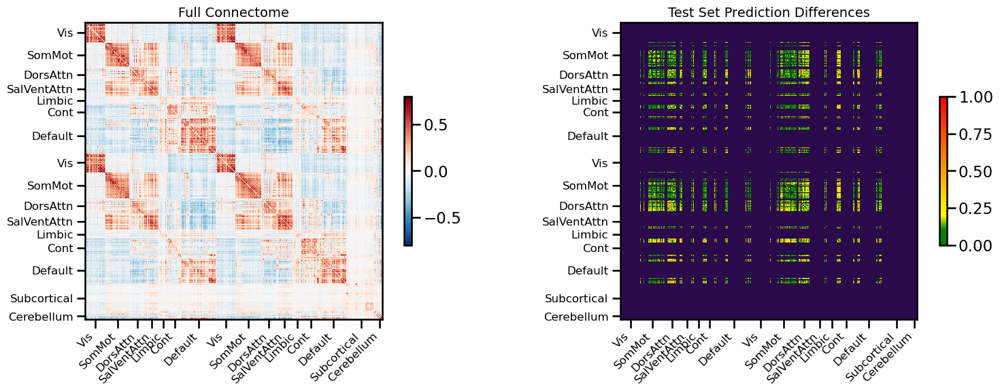

<Figure size 640x480 with 0 Axes>

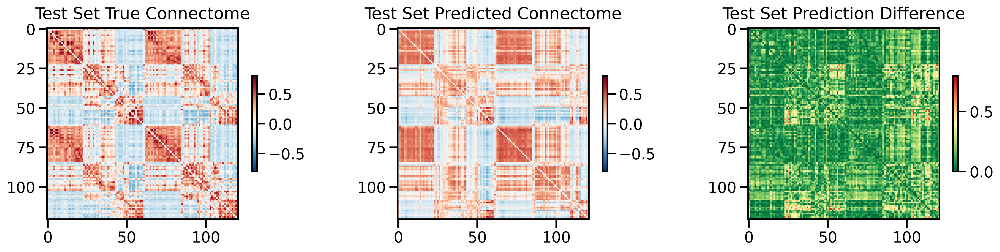

<Figure size 640x480 with 0 Axes>

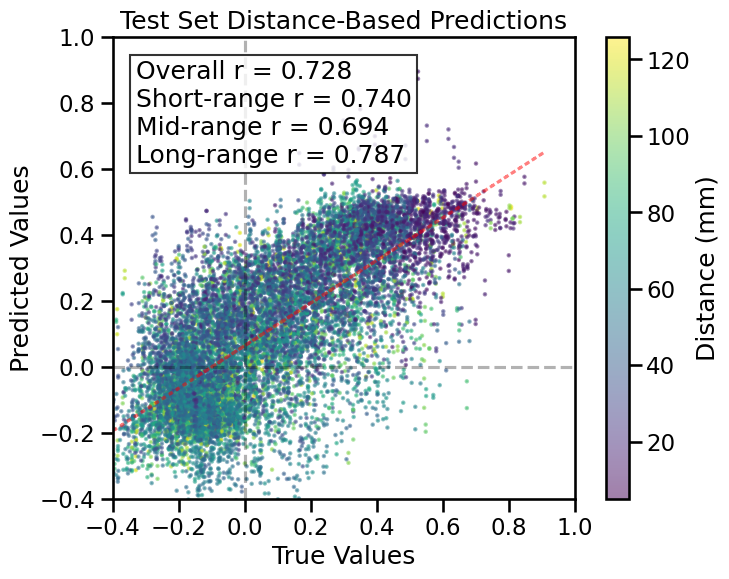

TRAIN METRICS
GLOBAL: mse=0.000868, mae=0.021794, r2=0.9721, pearson_r=0.9888, spearman_r=0.9837, geodesic_distance=14.3887
DISTANCE-BASED: short=0.9894, mid=0.9870, long=0.9854
HEMISPHERIC: left=0.9890, right=0.9892, inter=0.9883
CONNECTION STRENGTH: neg=0.7531, weak=0.9791, pos=0.9370
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9930    0.9895
  Default       0.9840    0.9870
  SalVentAttn    0.9845    0.9876
  Limbic        0.9921    0.9913
  DorsAttn      0.9915    0.9905
  SomMot        0.9881    0.9888
  Vis           0.9851    0.9883
  Subcortical    0.9951    0.9886
  Cerebellum    0.9277    0.9906

TEST METRICS
GLOBAL: mse=0.032845, mae=0.139817, r2=0.4787, pearson_r=0.7284, spearman_r=0.7132, geodesic_distance=9.4557
DISTANCE-BASED: short=0.7403, mid=0.6935, long=0.7872
HEMISPHERIC: left=0.7639, right=0.7325, inter=0.6964
CONNECTION STRENGTH: neg=0.3188, weak=0.5741, pos=0.1975
NETWORK CORRELATIONS:
  NETWORK      IN

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,▇▆█▇▅▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_mse_loss,█▅▅▄▄▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▂▂▂▂▁▂▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.03469
train_mse_loss,0.00187


Final evaluation metrics logged successfully.


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 8afelrbw
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/8afelrbw
Initialized sweep with ID: 8afelrbw


  warnings.warn(

  self.comm = Comm(**args)



Testing network: Frontal
Temporal
Occipital
Parietal
Subcortex
Cerebellum
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 20, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [512, 256, 128], 'cls_init': 'spatial_learned', 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 0.0001, 'weight_decay': 0.0001, 'batch_size': 1024, 'aug_prob': 0.4, 'epochs': 100, 'num_workers': 2, 'prefetch_factor': 4}
Number of learnable parameters in SMT w/ CLS model: 4686987


  from IPython.core.display import HTML, display  # type: ignore



Using 2 workers and 4 prefetch factor
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.15 GB
Best val loss so far at epoch 1: 0.0633
Best val loss so far at epoch 2: 0.0527
Best val loss so far at epoch 3: 0.0502
Best val loss so far at epoch 5: 0.0490
Epoch 5/100, Train Loss: 0.0745, Val Loss: 0.0490, Time: 11.92s
Best val loss so far at epoch 6: 0.0484
Epoch 10/100, Train Loss: 0.0472, Val Loss: 0.0503, Time: 12.51s
Epoch 15/100, Train Loss: 0.0349, Val Loss: 0.0548, Time: 11.10s
Epoch 20/100, Train Loss: 0.0288, Val Loss: 0.0554, Time: 10.62s

LR REDUCED: 0.000100 → 0.000030 at Val Loss: 0.053022
Epoch 25/100, Train Loss: 0.0233, Val Loss: 0.0516, Time: 10.12s
Epoch 30/100, Train Loss: 0.0194, Val Loss: 0.0568, Time: 9.61s
Epoch 35/100, Train Loss: 0.0202, Val Loss: 0.0505, Time: 9.49s
Epoch 40/100, Train Loss: 0.0170, Val Loss: 0.0507, Time: 9.27s

LR REDUCED: 0.000030 → 0.000009 at Val Loss: 0.049493
Epoch 45/100, Train Loss: 0.0198, Val Loss: 0.0495, Time: 9.

<Figure size 640x480 with 0 Axes>

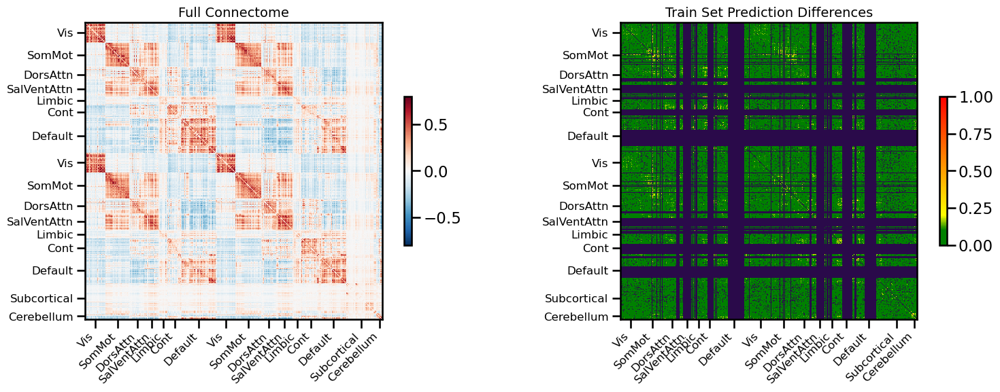

<Figure size 640x480 with 0 Axes>

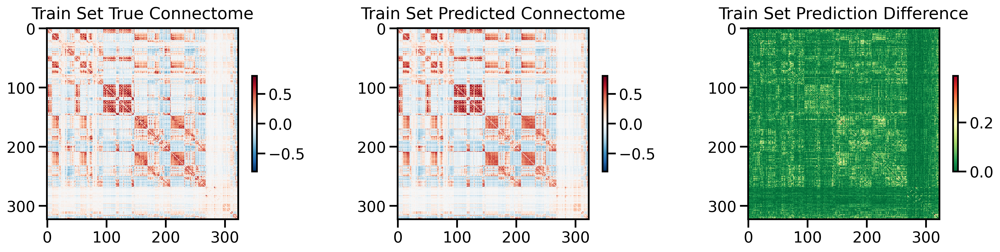

<Figure size 640x480 with 0 Axes>

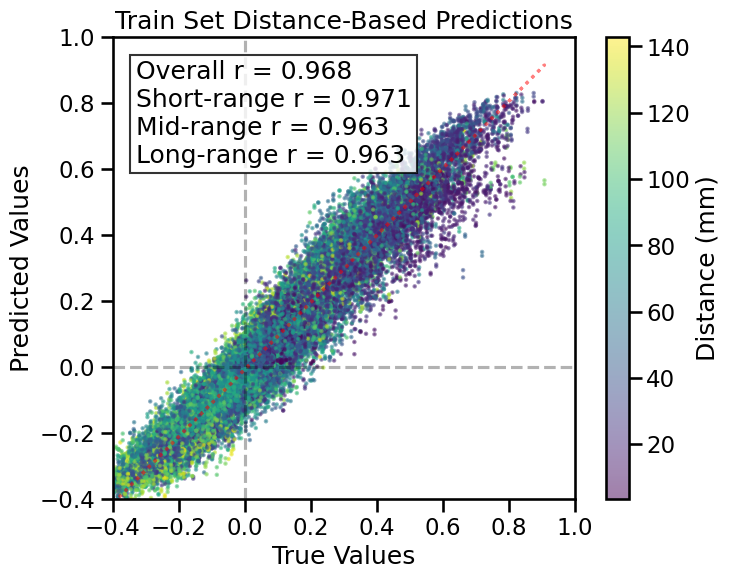

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 132 regions, 17292 connections


<Figure size 640x480 with 0 Axes>

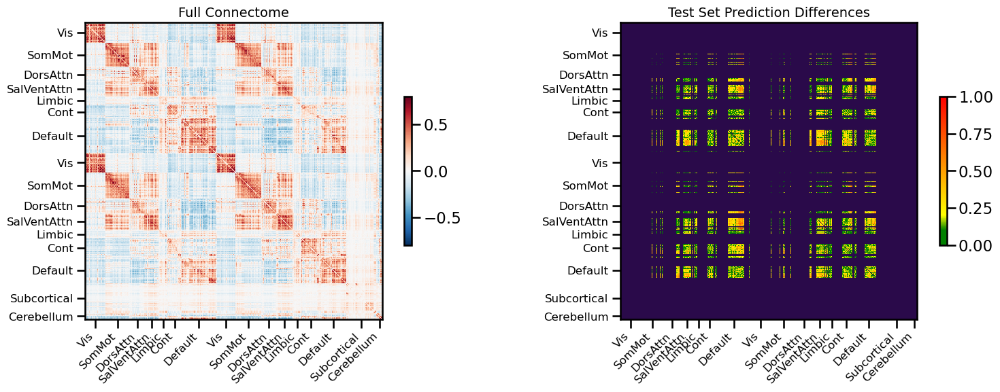

<Figure size 640x480 with 0 Axes>

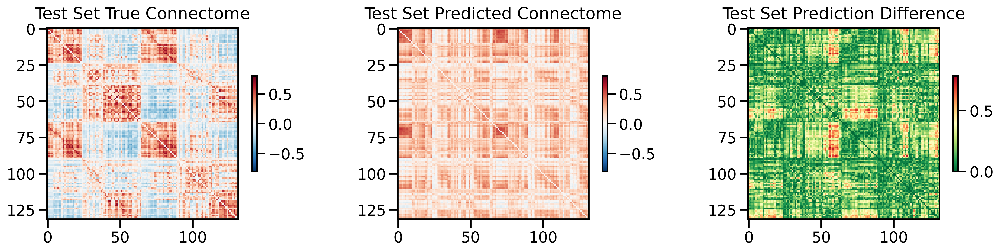

<Figure size 640x480 with 0 Axes>

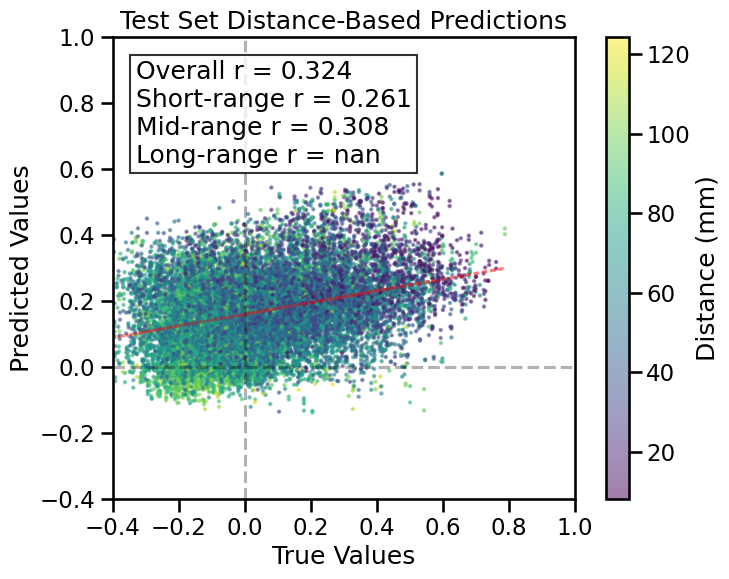

TRAIN METRICS
GLOBAL: mse=0.002405, mae=0.035576, r2=0.9298, pearson_r=0.9684, spearman_r=0.9581, geodesic_distance=16.9931
DISTANCE-BASED: short=0.9712, mid=0.9632, long=0.9634
HEMISPHERIC: left=0.9662, right=0.9678, inter=0.9714
CONNECTION STRENGTH: neg=0.4652, weak=0.9421, pos=0.7864
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9455    0.9602
  Default       0.9569    0.9637
  SalVentAttn    0.9564    0.9667
  Limbic        0.9839    0.9756
  DorsAttn      0.9596    0.9621
  SomMot        0.9709    0.9666
  Vis           0.9630    0.9672
  Subcortical    0.9596    0.9620
  Cerebellum    0.9625    0.9625

TEST METRICS
GLOBAL: mse=0.056352, mae=0.191099, r2=-0.2047, pearson_r=0.3242, spearman_r=0.3079, geodesic_distance=13.0131
DISTANCE-BASED: short=0.2607, mid=0.3083
HEMISPHERIC: left=0.2947, right=0.3430, inter=0.3291
CONNECTION STRENGTH: neg=-0.0395, weak=0.2453, pos=0.1383
NETWORK CORRELATIONS:
  NETWORK      INTRA      I

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▂▁▁▂▃▂▄▃▃▄▂▃▁▅▆▃▄▂▄▃▂▅▃▅▃▂▄▂▁▂▃▄▇▂▃▄▅▄▅
train_mse_loss,█▅▄▄▃▃▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.05625
train_mse_loss,0.01689


Final evaluation metrics logged successfully.


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: l1528mvn
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/l1528mvn
Initialized sweep with ID: l1528mvn


  warnings.warn(

  self.comm = Comm(**args)



Testing network: Subcortex
Temporal
Occipital
Parietal
Frontal
Cerebellum
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 20, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [512, 256, 128], 'cls_init': 'spatial_learned', 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 0.0001, 'weight_decay': 0.0001, 'batch_size': 1024, 'aug_prob': 0.4, 'epochs': 100, 'num_workers': 2, 'prefetch_factor': 4}
Number of learnable parameters in SMT w/ CLS model: 4686987


  from IPython.core.display import HTML, display  # type: ignore



Using 2 workers and 4 prefetch factor
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.15 GB
Best val loss so far at epoch 1: 0.0425
Best val loss so far at epoch 2: 0.0355
Best val loss so far at epoch 3: 0.0344
Best val loss so far at epoch 5: 0.0276
Epoch 5/100, Train Loss: 0.0615, Val Loss: 0.0276, Time: 17.43s
Best val loss so far at epoch 6: 0.0275
Epoch 10/100, Train Loss: 0.0455, Val Loss: 0.0415, Time: 18.12s
Best val loss so far at epoch 12: 0.0265
Epoch 15/100, Train Loss: 0.0357, Val Loss: 0.0401, Time: 17.83s
Epoch 20/100, Train Loss: 0.0255, Val Loss: 0.0424, Time: 15.55s
Epoch 25/100, Train Loss: 0.0273, Val Loss: 0.0424, Time: 16.40s

LR REDUCED: 0.000100 → 0.000030 at Val Loss: 0.064578
Epoch 30/100, Train Loss: 0.0251, Val Loss: 0.0677, Time: 16.71s
Epoch 35/100, Train Loss: 0.0178, Val Loss: 0.0911, Time: 14.34s
Epoch 40/100, Train Loss: 0.0161, Val Loss: 0.0702, Time: 13.78s
Epoch 45/100, Train Loss: 0.0151, Val Loss: 0.0684, Time: 13.45s
Best v

<Figure size 640x480 with 0 Axes>

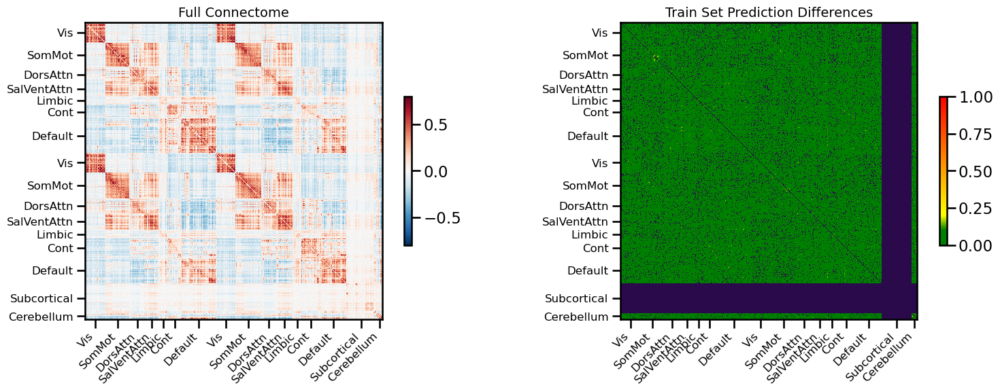

<Figure size 640x480 with 0 Axes>

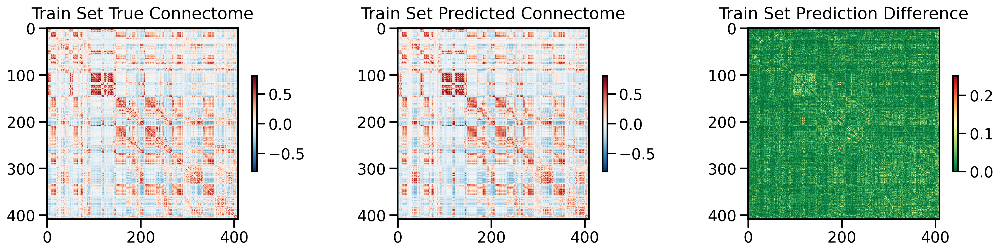

<Figure size 640x480 with 0 Axes>

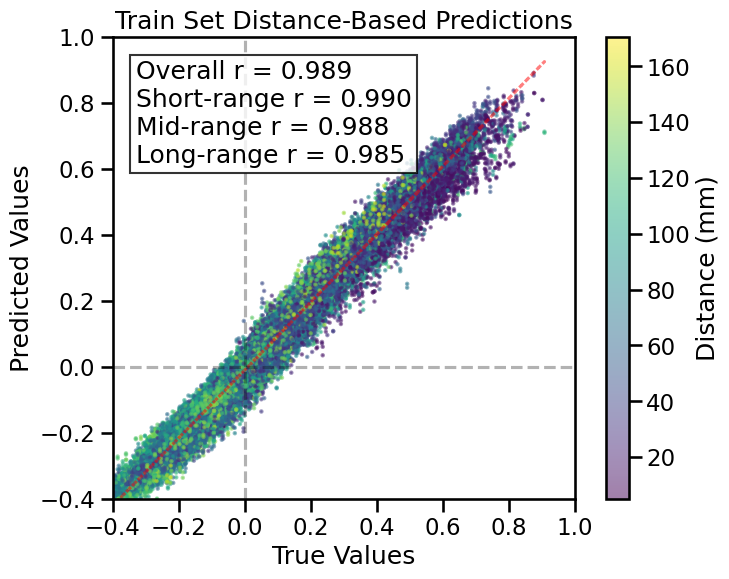

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 46 regions, 2070 connections


<Figure size 640x480 with 0 Axes>

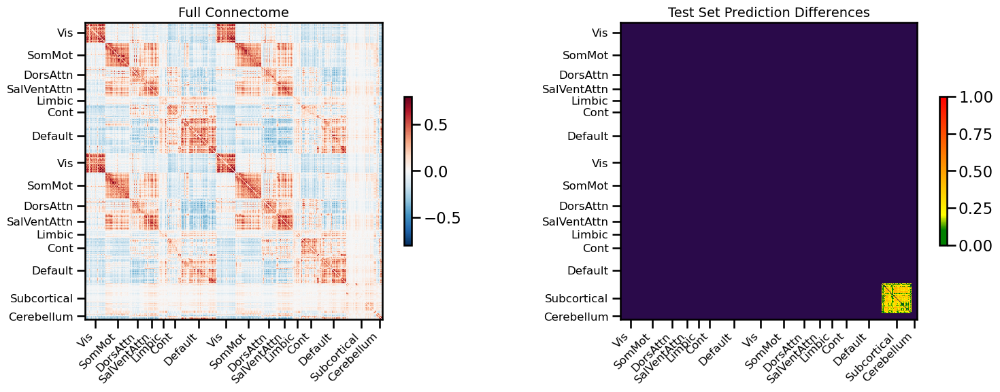

<Figure size 640x480 with 0 Axes>

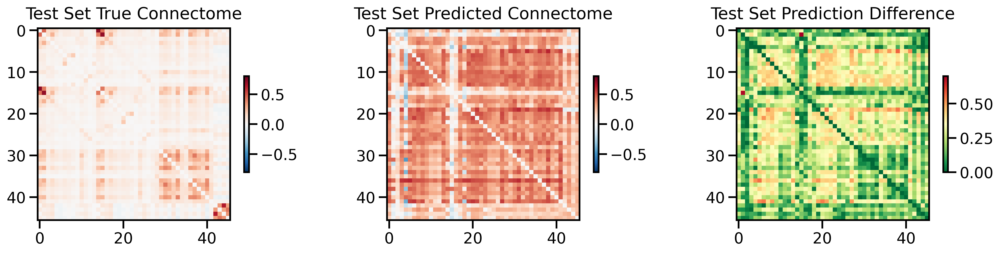

<Figure size 640x480 with 0 Axes>

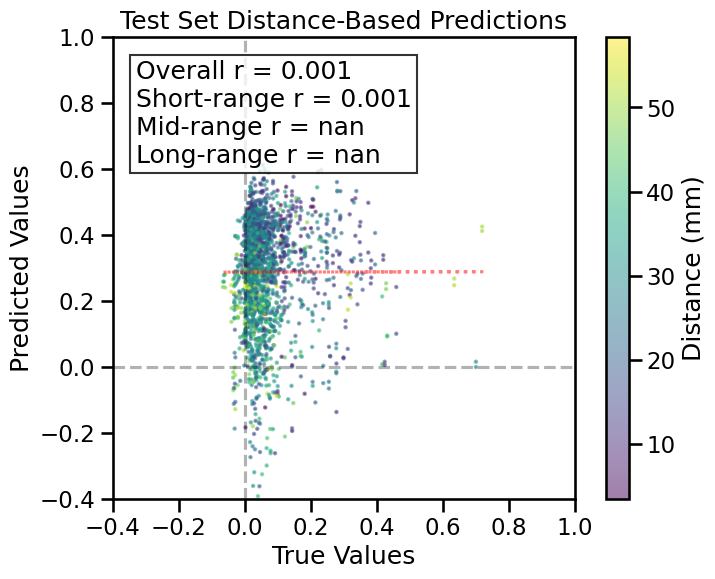

TRAIN METRICS
GLOBAL: mse=0.001059, mae=0.024888, r2=0.9738, pearson_r=0.9890, spearman_r=0.9867, geodesic_distance=12.2069
DISTANCE-BASED: short=0.9898, mid=0.9878, long=0.9853
HEMISPHERIC: left=0.9882, right=0.9900, inter=0.9887
CONNECTION STRENGTH: neg=0.7478, weak=0.9799, pos=0.9241
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9907    0.9899
  Default       0.9893    0.9893
  SalVentAttn    0.9891    0.9897
  Limbic        0.9927    0.9912
  DorsAttn      0.9907    0.9897
  SomMot        0.9873    0.9885
  Vis           0.9852    0.9873
  Cerebellum    0.9790    0.9903

TEST METRICS
GLOBAL: mse=0.082355, mae=0.255799, r2=-10.8475, pearson_r=0.0008, spearman_r=0.0275, geodesic_distance=12.8327
DISTANCE-BASED: short=0.0006
HEMISPHERIC: left=-0.0405, right=0.0020, inter=-0.0732
CONNECTION STRENGTH: weak=0.0252
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Subcortical   -0.0974       

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,▂▃▁▃▃▃▃▄▃▆▅▆█▆█▆▂▅▇▂▃▄▃▃▅▄▅▃▅▇▆▅▆▅▄▅▅▆▅▆
train_mse_loss,█▆▄▄▃▃▂▂▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.06977
train_mse_loss,0.00456


Final evaluation metrics logged successfully.


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: v8eisjlz
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/v8eisjlz
Initialized sweep with ID: v8eisjlz


  warnings.warn(

  self.comm = Comm(**args)



Testing network: Cerebellum
Temporal
Occipital
Parietal
Frontal
Subcortex
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'token_encoder_dim': 20, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [512, 256, 128], 'cls_init': 'spatial_learned', 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 0.0001, 'weight_decay': 0.0001, 'batch_size': 512, 'aug_prob': 0.45, 'epochs': 5, 'num_workers': 2, 'prefetch_factor': 4}
Number of learnable parameters in SMT w/ CLS model: 4686987


  from IPython.core.display import HTML, display  # type: ignore



Using 2 workers and 4 prefetch factor
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.15 GB
Best val loss so far at epoch 1: 0.0536

Reached final epoch 5. Restoring best model with Val Loss: 0.0536, Pearson Correlation: -0.1329
Running train evaluation...

=== TRAIN EVALUATION ===
Evaluating 446 regions, 198470 connections


<Figure size 640x480 with 0 Axes>

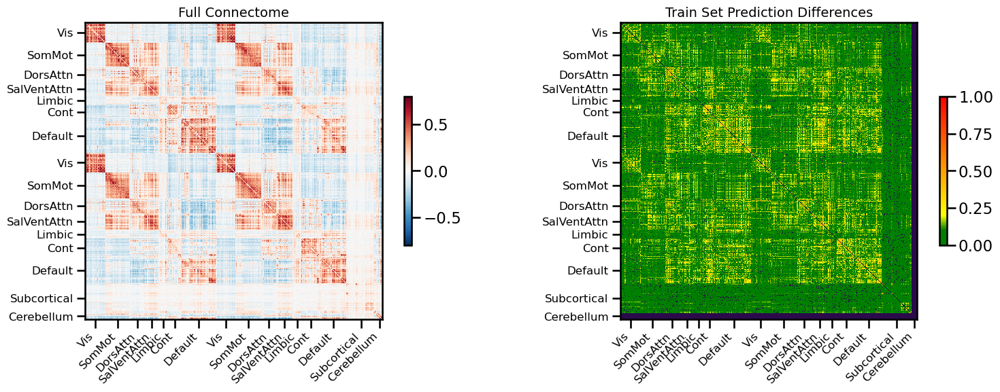

<Figure size 640x480 with 0 Axes>

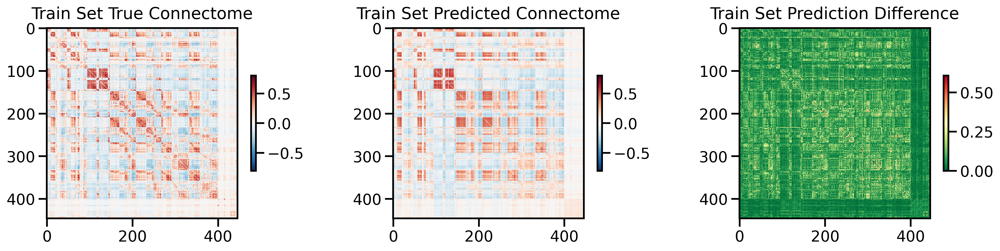

<Figure size 640x480 with 0 Axes>

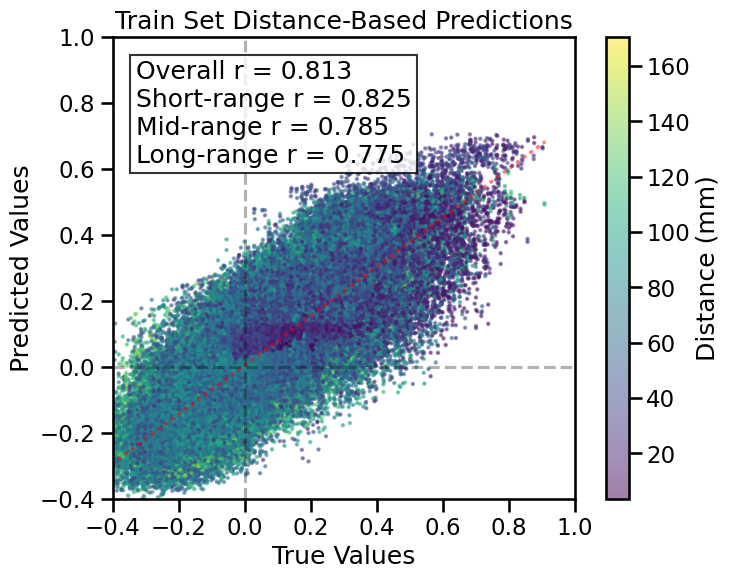

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 9 regions, 72 connections


<Figure size 640x480 with 0 Axes>

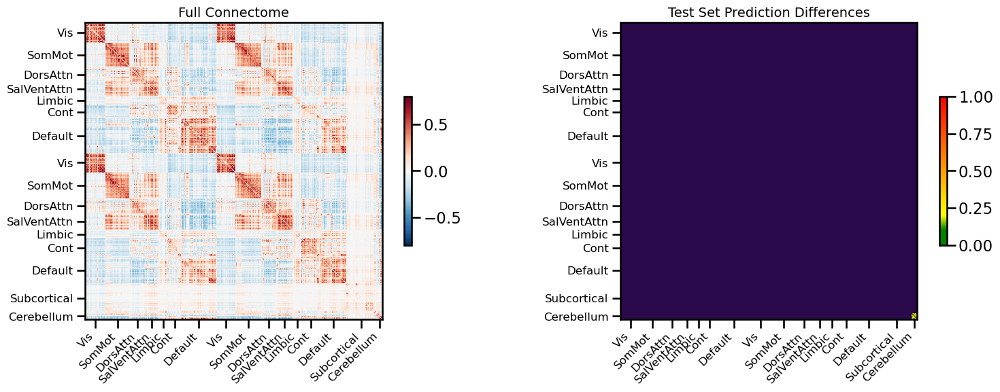

<Figure size 640x480 with 0 Axes>

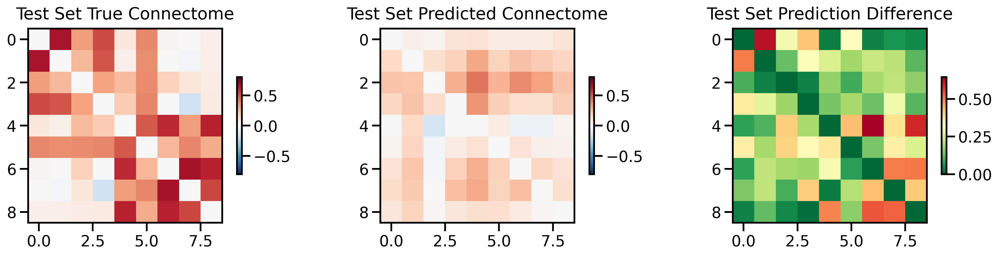

<Figure size 640x480 with 0 Axes>

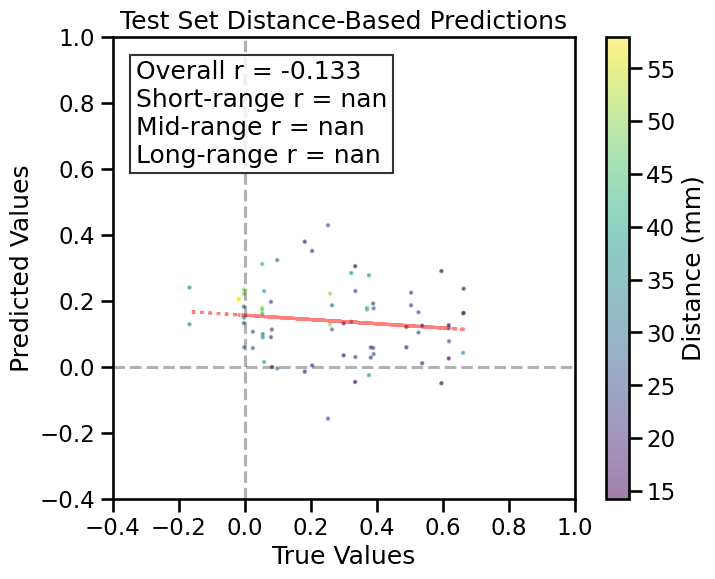

TRAIN METRICS
GLOBAL: mse=0.011678, mae=0.079968, r2=0.6498, pearson_r=0.8127, spearman_r=0.7893, geodesic_distance=24.0897
DISTANCE-BASED: short=0.8246, mid=0.7852, long=0.7750
HEMISPHERIC: left=0.8083, right=0.8200, inter=0.8146
CONNECTION STRENGTH: neg=0.1850, weak=0.7330, pos=0.3707
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.8213    0.8408
  Default       0.8221    0.8208
  SalVentAttn    0.8824    0.8329
  Limbic        0.8812    0.8551
  DorsAttn      0.8517    0.8344
  SomMot        0.7781    0.8065
  Vis           0.7845    0.8274
  Subcortical    0.7999    0.8208

TEST METRICS
GLOBAL: mse=0.087374, mae=0.247545, r2=-0.7202, pearson_r=-0.1329, spearman_r=-0.1680, geodesic_distance=6.7708
HEMISPHERIC: left=-0.3204
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cerebellum   -0.0632       N/A

BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 7380, 'binarize': False, 'toke

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,▁▂▆▆█
train_mse_loss,█▄▂▂▁
best_val_loss,0
test_mse_loss,0.08737
train_mse_loss,0.0218


Final evaluation metrics logged successfully.
CPU Usage: 15.2%
RAM Usage: 6.2%
Available RAM: 1.4T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |
Sim complete
Simulation completed in 5250.77 seconds (87.51 minutes)


8559

<Figure size 640x480 with 0 Axes>

In [8]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='UKBB',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='lobe',
              random_seed=42,
              search_method=('wandb', 'mse', 4),
              track_wandb=True,
              skip_cv=True,
              model_type='shared_transformer_cls',
              use_gpu=True, 
              null_model='none',
              use_folds=[0, 1, 2, 3, 4, 5]
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()